<a href="https://colab.research.google.com/github/far1din/manim/blob/main/visualizing-and-training-a-cnn/visualizing_a_cnn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1><b>
This notebook is for both "Visualizing Convolutional Neural Networks" and "Training a Convolutional Neural Network.</b></h1>

The animations are the same in both videos.

In [ ]:
'''
REMEMBER TO RESTART RUNTIME WHEN THIS HAS RAN
'''
!sudo apt update
!sudo apt install libcairo2-dev ffmpeg \
    texlive texlive-latex-extra texlive-fonts-extra \
    texlive-latex-recommended texlive-science \
    tipa libpango1.0-dev
!pip install manim
!pip install IPython --upgrade

In [34]:
from manim import *
from colour import Color
import copy

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

from matplotlib import pyplot as plt
import numpy as np

In [ ]:
'''
-----------------------------
%%manim -ql -v WARNING Video
%%manim -qm -v WARNING Video
%%manim -qh -v WARNING Video
-----------------------------

^^^ THE CODE IS ABOVE EVERY CELL AND "qL", "qM", "qH" INDICATES LOW, MEDIUM OR HIGH RESOLUTION.

    USE LOW WHEN WRITING THE CODE, TESTING STUFF ETC. AND HIGH WHEN PRODUCING THE FINAL VERSION.
'''

# **LOAD MNIST DATASET + MODEL WEIGHTS**

In [7]:
''' LOAD THE MNIST DATASET '''

dataset = tf.keras.datasets.mnist
(training_images, training_labels), (test_images, test_labels) = dataset.load_data()

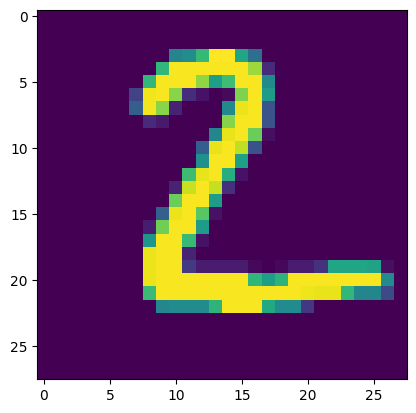

In [44]:
''' PICK IMAGE FOR VISUALIZATION '''

chosen_image = 1

mnist_og = test_images[ chosen_image ]
mnist = mnist_og.reshape(-1)

plt.imshow(mnist_og) # Visualize image

In [30]:
''' DEFINING THE MODEL IN TF '''

model = keras.Sequential(
    [
        keras.Input(shape=(28, 28, 1)),

        layers.Conv2D(filters = 2, kernel_size = (5, 5), strides = (1, 1), activation = 'relu'),  ## --> 24 x 24 x 8
        layers.MaxPool2D(pool_size=(2, 2)),                                                       ## --> 12 x 12 x 8

        layers.Conv2D(filters = 4, kernel_size = (3, 3), strides = (1, 1), activation = 'sigmoid'),  ## --> 10 x 10 x 32
        layers.MaxPool2D(pool_size = (2, 2)),                                                         ## --> 5 x 5 x 32
        layers.Flatten(),

        layers.Dense(10)
    ]
)

model.compile(
    loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    optimizer = keras.optimizers.Adam(learning_rate=3e-4),
    metrics=['accuracy']
)

model.evaluate(test_images, test_labels, batch_size=64)

157/157 [==============================] - 2s 9ms/step - loss: 2.8366 - accuracy: 0.0926


[2.836561918258667, 0.09260000288486481]

In [31]:
'''
!!! READ BEFORE RUNNING THE CELL !!!

1. Create a folder called mnist_model
2. Copy over the files in the epoch folder on github into the "mnist_model" folder. You should copy both M.index and M.data-00000-of-00001
3. Run the cell

Alternatively, just skip this cell and continue with the untrained model from the cell above.
'''

model.load_weights('mnist_model/M')

model.evaluate(test_images, test_labels, batch_size=64)

157/157 [==============================] - 1s 6ms/step - loss: 1.3343 - accuracy: 0.6469


[1.334317922592163, 0.6468999981880188]

# **Input Layer (28 x 28 x 1)**

In [ ]:
'''
SOMETIMES YOU WILL GET THE ERROR: FileNotFoundError: [Errno 2] No such file or directory: 'media/Tex'

Run this block to fix the error.
'''

In [39]:
run_tex_to_not_get_issues___this_sometimes_happen___this_variable_is_not_used = Tex('$fadf$')

[11/06/23 17:16:25] INFO     Writing $fadf$ to media/Tex/e05829adcf26a9f8.tex                ]8;id=868508;file:///usr/local/lib/python3.10/dist-packages/manim/utils/tex_file_writing.py\tex_file_writing.py]8;;\:]8;id=808814;file:///usr/local/lib/python3.10/dist-packages/manim/utils/tex_file_writing.py#97\97]8;;\

INFO:manim:Writing $fadf$ to media/Tex/e05829adcf26a9f8.tex


In [ ]:
input_layer = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (mnist[j]/255)), fill_opacity = (mnist[j]/255) ) for j in range(len(mnist))]).arrange_in_grid(28, 28, buff = 0)

input_layer1 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.2, (mnist[j]/255)), fill_opacity = (mnist[j]/255) ).add(Tex('$' + str(mnist[j]) + '$')) for j in range(len(mnist))]).arrange_in_grid(28, 28, buff = 0)
input_layer2 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=.2, fill_opacity = 0 ).add(Tex('$' + str(mnist[j]) + '$')) for j in range(len(mnist))]).arrange_in_grid(28, 28, buff = 0)

input_layer.save_state()
input_layer1.save_state()
input_layer2.save_state()

In [47]:
inp2 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (test_images[19].flatten()[j]/255)), fill_opacity = (test_images[19].flatten()[j]/255) ) for j in range(len(test_images[19].flatten()))]).arrange_in_grid(28, 28, buff = 0)

In [ ]:
inp2.save_state()

In [52]:
%%manim -ql -v WARNING --disable_caching Positioning

class Positioning(Scene):
    def construct(self):
      # plane = NumberPlane()
      # self.add(plane)
      input_layer.restore()
      input_layer1.restore()
      input_layer2.restore()

      input_layer.scale(.2).move_to((-4, .2, 0))
      input_layer1.scale(.2).move_to((-4, .2, 0))
      input_layer2.scale(.2).move_to((-4, .2, 0))

      self.add(input_layer, SurroundingRectangle(input_layer, buff=0, color=WHITE) )

      ## INPUT LAYER TEXT ##
      input_layer_brace = Brace(input_layer, DOWN)
      input_layer_text  = Text('Input Layer (28 x 28 x 1)').scale(.4).next_to(input_layer_brace, DOWN)


      ## START ##
      self.play( Create(input_layer_brace), Write(input_layer_text) )
      self.wait(2)

In [ ]:
k11 = VGroup(*[Square(side_length=1, color=YELLOW, fill_opacity = 0.4).add(Tex('$0.0023$').scale(.5)) for i in range(25) ]).arrange_in_grid(5, 5, buff=0)
k11.save_state()

k12 = VGroup(*[Square(side_length=1, color=TEAL, fill_opacity = 0.4).add(Tex('$0.0023$').scale(.5)) for i in range(25) ]).arrange_in_grid(5, 5, buff=0)
k12.save_state()

# **Conv Layer 1 (5 x 5 x 1) x 2**

**WEIGHTS + BIAS L1**

In [54]:
weights11_np = np.round(model.layers[0].get_weights()[0][:, :, 0, 0], 3).flatten()
weights12_np = np.round(model.layers[0].get_weights()[0][:, :, 0, 1], 3).flatten()

In [55]:
bias11_np = np.round(model.layers[0].get_weights()[1][0], 3)
bias12_np = np.round(model.layers[0].get_weights()[1][1], 3)

In [56]:
k11 = VGroup(*[Square(side_length=1, color=YELLOW, fill_opacity = 0.4).add(Tex('$' + str(weights11_np[i]) + '$').scale(.5)) for i in range(25) ]).arrange_in_grid(5, 5, buff=0)
k11.save_state()

k12 = VGroup(*[Square(side_length=1, color=TEAL, fill_opacity = 0.4).add(Tex('$' + str(weights12_np[i]) + '$').scale(.5)) for i in range(25) ]).arrange_in_grid(5, 5, buff=0)
k12.save_state()

VGroup(Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square, Square)

In [57]:
bias11 = Tex('$,\ $', '$' + str(bias11_np) + '$')
bias11.save_state()

bias12 = Tex('$,\ $', '$' + str(bias12_np) + '$')
bias12.save_state()

Tex('$,\\ $$0.108$')

**OUTPUT**

In [58]:
layer1_output1_np = np.round(tf.keras.Model(model.input, model.get_layer( model.layers[0].name ).output)(mnist_og[None, ...])[0][:, :, 0].numpy().reshape(-1), 1)
layer1_output2_np = np.round(tf.keras.Model(model.input, model.get_layer( model.layers[0].name ).output)(mnist_og[None, ...])[0][:, :, 1].numpy().reshape(-1), 1)

In [ ]:
layer1_output1 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.05, ( layer1_output1_np[j]/layer1_output1_np.max() )), fill_opacity = ( layer1_output1_np[j]/layer1_output1_np.max() )  ) for j in range(len(layer1_output1_np))]).arrange_in_grid(24, 24, buff = 0)
layer1_output1.save_state()

layer1_output2 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.05, ( layer1_output2_np[j]/layer1_output2_np.max() )), fill_opacity = ( layer1_output2_np[j]/layer1_output2_np.max() ) ) for j in range(len(layer1_output2_np))]).arrange_in_grid(24, 24, buff = 0)
layer1_output2.save_state()

layer1_output1_t = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=.1, fill_opacity = 0 ).add(Tex('$' + str(layer1_output1_np[j]) + '$').scale(.85)) for j in range(len(layer1_output1_np))]).arrange_in_grid(24, 24, buff = 0)
layer1_output1_t.save_state()

layer1_output2_t = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=.1, fill_opacity = 0 ).add(Tex('$' + str(layer1_output2_np[j]) + '$').scale(.85)) for j in range(len(layer1_output2_np))]).arrange_in_grid(24, 24, buff = 0)
layer1_output2_t.save_state()

In [60]:
%%manim -ql -v WARNING --disable_caching Positioning

''' 2.0 - ANIMATE IN THE WEIGHTS, BIASES ETC. '''
class Positioning(Scene):
    def construct(self):
      # plane = NumberPlane()
      # self.add(plane)
      input_layer.restore()
      input_layer2.restore()
      k11.restore()
      k12.restore()
      bias11.restore()
      bias12.restore()

      ## INPUT LAYER ##
      # Input
      input_layer.scale(.2).move_to((-4, .2, 0))
      input_layer2.scale(.2).move_to((-4, .2, 0))

      # Text
      input_layer_brace = Brace(input_layer, DOWN)
      input_layer_text  = Text('Input Layer (28 x 28 x 1)').scale(.4).next_to(input_layer_brace, DOWN)
      input_layer_box   = SurroundingRectangle(input_layer, color=WHITE, buff=0)

      self.add(input_layer, input_layer_brace, input_layer_text, input_layer_box)


      ## KERNELS ##
      k11.scale(.5).move_to( (1, 1.5, 0) )
      k11_brace = Brace(k11, RIGHT)
      k11_text  = Text('Kernel 1 (5 x 5 x 1)').scale(.4).next_to(k11_brace, RIGHT)

      k12.scale(.5).next_to( k11, DOWN )
      k12_brace = Brace(k12, RIGHT)
      k12_text  = Text('Kernel 2 (5 x 5 x 1)').scale(.4).next_to(k12_brace, RIGHT)

      bias11.scale(.5).next_to(k11, RIGHT)
      bias11_brace = Brace(bias11[1], DOWN)
      bias11_text  = Text('Bias 1').scale(.4).next_to(bias11_brace, DOWN)

      bias12.scale(.5).next_to(k12, RIGHT)
      bias12_brace = Brace(bias12[1], DOWN)
      bias12_text  = Text('Bias 2').scale(.4).next_to(bias12_brace, DOWN)

      combined_k_brace = Brace(k12, DOWN)
      combined_k_text  = Text('Kernels =  2 x (5 x 5 x 1)').scale(.4).next_to(combined_k_brace, DOWN)
      combined_k_text1  = Text('Stride = 1, Activation = ReLU').scale(.4).next_to(combined_k_text, DOWN*.5)

      ## START ##
      TT = Text('Convolutional Layer 1').scale(.7).to_edge(UP + RIGHT)

      self.play( Write(TT) )
      self.play(FadeIn(k11, k12))
      self.wait(2)
      self.play( Create(combined_k_brace), Write(combined_k_text) )
      self.wait(2)
      self.play( Write(bias11), Write(bias12), Create(bias11_brace), Create(bias12_brace), Write(bias11_text), Write(bias12_text) )
      self.wait(2)
      self.play(FadeOut(bias11_brace, bias12_brace, bias11_text, bias12_text))
      self.wait(2)
      self.play( Write(combined_k_text1) )
      self.wait(2)
      self.play(FadeOut(TT))
      self.wait(2)

In [61]:
%%manim -ql -v WARNING --disable_caching Positioning

'''
2.1 - ANIMATE THE CONVOLUTION
PS. This cell might take 10m or so to run on qL. High quality might take longer.
If the animation is not rendered in the below the cell, you will find it in the media folder under media/videos/content/[resolution (example: 480p15)]/Positioning.mp4
'''
class Positioning(Scene):
    def construct(self):
      # plane = NumberPlane()
      # self.add(plane)
      input_layer.restore()
      input_layer2.restore()
      k11.restore()
      k12.restore()
      bias11.restore()
      bias12.restore()
      layer1_output1.restore()
      layer1_output2.restore()

      ## INPUT LAYER ##
      # Input
      input_layer.scale(.2).move_to((-4, .2, 0))
      input_layer2.scale(.2).move_to((-4, .2, 0))

      # Text
      input_layer_brace = Brace(input_layer, DOWN)
      input_layer_text  = Text('Input Layer (28 x 28 x 1)').scale(.4).next_to(input_layer_brace, DOWN)
      input_layer_box   = SurroundingRectangle(input_layer, color=WHITE, buff=0)

      self.add(input_layer, input_layer_brace, input_layer_text, input_layer_box)


      ## KERNELS ##

      # Kernels
      k11.scale(.5).move_to( (1, 1.5, 0) )
      k12.scale(.5).next_to( k11, DOWN )

      # Bias
      bias11.scale(.5).next_to(k11, RIGHT)
      bias12.scale(.5).next_to(k12, RIGHT)

      # Combined text
      combined_k_brace = Brace(k12, DOWN)
      combined_k_text  = Text('Kernels =  2 x (5 x 5 x 1)').scale(.4).next_to(combined_k_brace, DOWN)
      combined_k_text1  = Text('Stride = 1, Activation = ReLU').scale(.4).next_to(combined_k_text, DOWN*.5)

      self.add(k11, k12, bias11, bias12, combined_k_brace, combined_k_text, combined_k_text1)


      ### START ###
      # Kernel Animation Squares
      k11_anim = Square(stroke_opacity=.5, side_length=5).set_fill(YELLOW, opacity=.5).scale(.2).align_to(input_layer, LEFT + UP)
      k12_anim = Square(stroke_opacity=.5, side_length=5).set_fill(TEAL, opacity=.5).scale(.2).align_to(input_layer, LEFT + UP)

      # Output Layer 1
      layer1_output1.scale(.13).move_to((5.2, 1.7, 0))
      layer1_output2.scale(.13).next_to(layer1_output1, DOWN)

      border_layer1_output1 = SurroundingRectangle(layer1_output1, buff=0, color=WHITE)
      brace_layer1_output1  = Brace(border_layer1_output1, DOWN)
      text_layer1_output1   = Text('Activation 1, Layer 1').scale(.4).next_to(brace_layer1_output1, DOWN)

      border_layer1_output2 = SurroundingRectangle(layer1_output2, buff=0, color=WHITE)
      brace_layer1_output2  = Brace(border_layer1_output2, DOWN, buff=0.1)
      text_layer1_output2   = Text('Activation 2, Layer 1').scale(.4).next_to(brace_layer1_output2, DOWN, buff=.1)

      # FILTER 1 ANIM
      self.play(Create(border_layer1_output1), Create(brace_layer1_output1), Write(text_layer1_output1) )
      self.wait(2)
      self.play( ReplacementTransform( copy.deepcopy(k11), k11_anim ) )
      self.wait(1)


      x = 0
      for h in range(24):
        k11_anim.align_to(input_layer, LEFT + UP).shift( [0, -.2*h, 0] )

        self.play( FadeIn(layer1_output1[x]), run_time=.0007 )
        x = x + 1
        for w in range( 24 ):
          if w > 0:
            self.play( k11_anim.animate.shift( [.2, 0, 0] ), FadeIn(layer1_output1[x]), run_time=.0007 )
            x = x + 1

      self.play( FadeOut(brace_layer1_output1, text_layer1_output1, k11_anim) )
      self.wait(2)


      # FILTER 2 ANIM
      self.play(Create(border_layer1_output2), Create(brace_layer1_output2), Write(text_layer1_output2) )
      self.wait(2)
      self.play( ReplacementTransform( copy.deepcopy(k12), k12_anim ) )
      self.wait(1)


      x = 0
      for h in range(24):
        k12_anim.align_to(input_layer, LEFT + UP).shift( [0, -.2*h, 0] )

        self.play( FadeIn(layer1_output2[x]), run_time=.0007 )
        x = x + 1
        for w in range( 24 ):
          if w > 0:
            self.play( k12_anim.animate.shift( [.2, 0, 0] ), FadeIn(layer1_output2[x]), run_time=.0007 )
            x = x + 1

      self.play( FadeOut(brace_layer1_output2, text_layer1_output2, k12_anim) )
      self.wait(2)
      CCC = Group(input_layer, input_layer_brace, input_layer_text, input_layer_box, layer1_output1, border_layer1_output1, layer1_output2, border_layer1_output2, k11, k12, bias11, bias12, combined_k_brace, combined_k_text, combined_k_text1)
      self.play( CCC.animate.shift(LEFT*10.55) )
      self.wait(2)

# **MaxPool Layer 1 (2 x 2)**

In [62]:
maxpool1_output1_np = np.round(tf.keras.Model(model.input, model.get_layer( model.layers[1].name ).output)(mnist_og[None, ...])[0][:, :, 0].numpy(), 1).flatten()
maxpool1_output2_np = np.round(tf.keras.Model(model.input, model.get_layer( model.layers[1].name ).output)(mnist_og[None, ...])[0][:, :, 1].numpy(), 1).flatten()

In [ ]:
maxpool1_output1 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (maxpool1_output1_np[j]/maxpool1_output1_np.max())), fill_opacity = (maxpool1_output1_np[j]/maxpool1_output1_np.max()) ) for j in range(len(maxpool1_output1_np))]).arrange_in_grid(12, 12, buff = 0)
maxpool1_output1.save_state()

maxpool1_output2 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (maxpool1_output2_np[j]/maxpool1_output2_np.max())), fill_opacity = (maxpool1_output2_np[j]/maxpool1_output2_np.max()) ) for j in range(len(maxpool1_output2_np))]).arrange_in_grid(12, 12, buff = 0)
maxpool1_output2.save_state()

In [ ]:
maxpool1_output1_t = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=.1, fill_opacity = 0 ).add(Tex('$' + str(maxpool1_output1_np[j]) + '$').scale(.75)) for j in range(len(maxpool1_output1_np))]).arrange_in_grid(12, 12, buff = 0)
maxpool1_output1_t.save_state()

maxpool1_output2_t = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=.1, fill_opacity = 0 ).add(Tex('$' + str(maxpool1_output2_np[j]) + '$').scale(.75)) for j in range(len(maxpool1_output2_np))]).arrange_in_grid(12, 12, buff = 0)
maxpool1_output2_t.save_state()

In [65]:
# Maxpool square
maxpool = VGroup(*[Square(side_length=1, color=RED ) for j in range(4)]).arrange_in_grid(2, 2, buff = 0)
maxpool.save_state()

VGroup(Square, Square, Square, Square)

In [66]:
slice_m0_np = [6.3, 4.0, 0, 0]
slice_m0 = VGroup(*[Square(side_length=1, color=WHITE ).add(Tex('$' + str(slice_m0_np[j]) + '$')) for j in range(4)]).arrange_in_grid(2, 2, buff = 0)
slice_m0.save_state()

slice_m1_np = [5.4, 2.2, 0, 0]
slice_m1 = VGroup(*[Square(side_length=1, color=WHITE ).add(Tex('$' + str(slice_m1_np[j]) + '$')) for j in range(4)]).arrange_in_grid(2, 2, buff = 0)
slice_m1.save_state()

VGroup(Square, Square, Square, Square)

In [67]:
%%manim -ql -v WARNING --disable_caching Positioning

''' 3.0 - ANIMATE THE MAX POOLING LAYER '''
class Positioning(Scene):
    def construct(self):
      # plane = NumberPlane()
      # self.add(plane)
      layer1_output1.restore()
      layer1_output2.restore()
      layer1_output1_t.restore()
      layer1_output2_t.restore()
      maxpool.restore()
      maxpool1_output1.restore()
      maxpool1_output2.restore()

        # Output Layer 1
      layer1_output1.scale(.13).move_to((5.2, 1.7, 0)).shift(LEFT*10.55)
      layer1_output2.scale(.13).next_to(layer1_output1, DOWN)
      layer1_output2_t.scale(.13).next_to(layer1_output1, DOWN)

      border_layer1_output1 = SurroundingRectangle(layer1_output1, buff=0, color=WHITE)
      border_layer1_output2 = SurroundingRectangle(layer1_output2, buff=0, color=WHITE)

      # MaxPool
      maxpool.scale(0.7).next_to( Group(layer1_output1, layer1_output2), RIGHT*3 )
      # MaxPool Animation Square
      maxpool_anim = Square(stroke_opacity=.5, side_length=2, color=RED).set_fill(RED, opacity=.2).scale(.13).align_to(layer1_output1, LEFT + UP)

      # MaxPool Output
      maxpool1_output1.scale(.25).next_to(maxpool, RIGHT*3).shift(UP*2)
      maxpool1_output2.scale(.25).next_to(maxpool, RIGHT*3).shift(DOWN*2)
      border_maxpool1_output1 = SurroundingRectangle(maxpool1_output1, buff=0, color=WHITE)
      border_maxpool1_output2 = SurroundingRectangle(maxpool1_output2, buff=0, color=WHITE)


      self.add(layer1_output1, layer1_output2, border_layer1_output1, border_layer1_output2)


      maxpool_text = Text('MaxPooling').to_edge(RIGHT + UP)
      maxpool_specs = Text('Pool Size = (2 x 2), Stride = 2').scale(.4).next_to(maxpool_text, DOWN)


      ### START ###
      self.play( Write(maxpool_text), Write(maxpool_specs) )
      self.wait(2)
      self.play(FadeIn(maxpool))
      self.wait(2)

      ## Channel 1 ##
      self.play( ReplacementTransform( copy.deepcopy(maxpool), maxpool_anim ) )
      self.wait(1)

      self.play(Create(border_maxpool1_output1))

      x = 0
      for h in range(12):
        maxpool_anim.align_to(layer1_output1, LEFT + UP).shift( [0, -.26*h, 0] )

        self.play( FadeIn(maxpool1_output1[x]), run_time=.02 )
        x = x + 1
        for w in range( 12 ):
          if w > 0:
            self.play( maxpool_anim.animate.shift( [.26, 0, 0] ), FadeIn(maxpool1_output1[x]), run_time=.02 )
            x = x + 1

      self.wait(1)
      self.play(FadeOut(maxpool_anim))
      self.wait(2)

      ## Channel 2 ##
      maxpool_anim.align_to(layer1_output2, LEFT + UP)
      self.play( ReplacementTransform( copy.deepcopy(maxpool), maxpool_anim ) )
      self.play(Create(border_maxpool1_output2))

      self.wait(1)

      x = 0
      for h in range(12):
        maxpool_anim.align_to(layer1_output2, LEFT + UP).shift( [0, -.26*h, 0] )

        self.play( FadeIn(maxpool1_output2[x]), run_time=.02 )
        x = x + 1
        for w in range( 12 ):
          if w > 0:
            self.play( maxpool_anim.animate.shift( [.26, 0, 0] ), FadeIn(maxpool1_output2[x]), run_time=.02 )
            x = x + 1

      self.wait(1)
      self.play(FadeOut(maxpool_anim))
      self.wait(2)

      DDD = Group( layer1_output1, layer1_output2, border_layer1_output1, border_layer1_output2, maxpool, maxpool1_output1, maxpool1_output2, border_maxpool1_output1, border_maxpool1_output2 )
      self.play( DDD.animate.shift(LEFT*6), FadeOut( Group(maxpool_text, maxpool_specs), shift=LEFT*6 ) )


# **Conv Layer 2 (3 x 3 x 2) x 4**

**WEIGHTS 2**

In [68]:
weights21_1_np = np.round(model.layers[2].get_weights()[0][:, :, 0, 0], 3).flatten()
weights21_2_np = np.round(model.layers[2].get_weights()[0][:, :, 1, 0], 3).flatten()

weights22_1_np = np.round(model.layers[2].get_weights()[0][:, :, 0, 1], 3).flatten()
weights22_2_np = np.round(model.layers[2].get_weights()[0][:, :, 1, 1], 3).flatten()

weights23_1_np = np.round(model.layers[2].get_weights()[0][:, :, 0, 2], 3).flatten()
weights23_2_np = np.round(model.layers[2].get_weights()[0][:, :, 1, 2], 3).flatten()

weights24_1_np = np.round(model.layers[2].get_weights()[0][:, :, 0, 3], 3).flatten()
weights24_2_np = np.round(model.layers[2].get_weights()[0][:, :, 1, 3], 3).flatten()

In [69]:
bias21_np = np.round(model.layers[2].get_weights()[1][0], 3)
bias22_np = np.round(model.layers[2].get_weights()[1][1], 3)
bias23_np = np.round(model.layers[2].get_weights()[1][2], 3)
bias24_np = np.round(model.layers[2].get_weights()[1][3], 3)

In [70]:
bias21 = Tex('$,\ ' + str(bias21_np) + '$')
bias21.save_state()

bias22 = Tex('$,\ ' + str(bias22_np) + '$')
bias22.save_state()

bias23 = Tex('$,\ ' + str(bias23_np) + '$')
bias23.save_state()

bias24 = Tex('$,\ ' + str(bias24_np) + '$')
bias24.save_state()

Tex('$,\\ -0.25$')

In [71]:
## FIRST ##
k21_1 = VGroup(*[Square(side_length=1, color=YELLOW, fill_opacity = 0.4).add(Tex('$' + str(weights21_1_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0).set_z_index(1)
k21_1.save_state()

k21_2 = VGroup(*[Square(side_length=1, color=TEAL, fill_opacity = 0.4).add(Tex('$' + str(weights21_2_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0)
k21_2.save_state()

## SECOND ##
k22_1 = VGroup(*[Square(side_length=1, color=ORANGE, fill_opacity = 0.4).add(Tex('$' + str(weights22_1_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0).set_z_index(1)
k22_1.save_state()

k22_2 = VGroup(*[Square(side_length=1, color=GREEN, fill_opacity = 0.4).add(Tex('$' + str(weights22_2_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0)
k22_2.save_state()

## THIRD ##
k23_1 = VGroup(*[Square(side_length=1, color=PURPLE, fill_opacity = 0.4).add(Tex('$' + str(weights23_1_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0).set_z_index(1)
k23_1.save_state()

k23_2 = VGroup(*[Square(side_length=1, color=GOLD, fill_opacity = 0.4).add(Tex('$' + str(weights23_2_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0)
k23_2.save_state()

## FOURTH ##
k24_1 = VGroup(*[Square(side_length=1, color=PINK, fill_opacity = 0.4).add(Tex('$' + str(weights24_1_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0).set_z_index(1)
k24_1.save_state()

k24_2 = VGroup(*[Square(side_length=1, color=BLUE, fill_opacity = 0.4).add(Tex('$' + str(weights24_2_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0)
k24_2.save_state()

VGroup(Square, Square, Square, Square, Square, Square, Square, Square, Square)

**OUTPUT**

In [72]:
layer2_output1_np = tf.keras.Model(model.input, model.get_layer( model.layers[2].name ).output)(mnist_og[None, ...])[0][:, :, 0].numpy().reshape(-1)
layer2_output2_np = tf.keras.Model(model.input, model.get_layer( model.layers[2].name ).output)(mnist_og[None, ...])[0][:, :, 1].numpy().reshape(-1)
layer2_output3_np = tf.keras.Model(model.input, model.get_layer( model.layers[2].name ).output)(mnist_og[None, ...])[0][:, :, 2].numpy().reshape(-1)
layer2_output4_np = tf.keras.Model(model.input, model.get_layer( model.layers[2].name ).output)(mnist_og[None, ...])[0][:, :, 3].numpy().reshape(-1)

In [ ]:
layer2_output1 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (layer2_output1_np[j]/layer2_output1_np.max())), fill_opacity = layer2_output1_np[j]/layer2_output1_np.max() ) for j in range(len(layer2_output1_np))]).arrange_in_grid(10, 10, buff = 0)
layer2_output1.save_state()

layer2_output2 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (layer2_output2_np[j]/layer2_output2_np.max())), fill_opacity = layer2_output2_np[j]/layer2_output2_np.max() ) for j in range(len(layer2_output2_np))]).arrange_in_grid(10, 10, buff = 0)
layer2_output2.save_state()

layer2_output3 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (layer2_output3_np[j]/layer2_output3_np.max())), fill_opacity = layer2_output3_np[j]/layer2_output3_np.max() ) for j in range(len(layer2_output3_np))]).arrange_in_grid(10, 10, buff = 0)
layer2_output3.save_state()

layer2_output4 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (layer2_output4_np[j]/layer2_output4_np.max())), fill_opacity = layer2_output4_np[j]/layer2_output4_np.max() ) for j in range(len(layer2_output4_np))]).arrange_in_grid(10, 10, buff = 0)
layer2_output4.save_state()

In [74]:
%%manim -ql -v WARNING --disable_caching Positioning

''' 4.0 - ANIMATE THE WEIGHTS, BIASES ETC FOR THE SECOND CONVOLUTIONAL LAYER '''
class Positioning(Scene):
    def construct(self):
      # plane = NumberPlane()
      # self.add(plane)
      layer1_output1.restore()
      layer1_output2.restore()
      maxpool.restore()
      maxpool1_output1.restore()
      maxpool1_output2.restore()
      k21_1.restore()
      k21_2.restore()
      k22_1.restore()
      k22_2.restore()
      k23_1.restore()
      k23_2.restore()
      k24_1.restore()
      k24_2.restore()

      bias21 = Text(', ' + str(bias21_np))
      bias22 = Text(', ' + str(bias22_np))
      bias23 = Text(', ' + str(bias23_np))
      bias24 = Text(', ' + str(bias24_np))


      # Output Layer 1
      layer1_output1.scale(.13).move_to((5.2, 1.7, 0)).shift(LEFT*10.55)
      layer1_output2.scale(.13).next_to(layer1_output1, DOWN)

      # MaxPool
      maxpool.scale(0.7).next_to( Group(layer1_output1, layer1_output2), RIGHT*3 )
      maxpool1_output1.scale(.25).next_to(maxpool, RIGHT*3).shift(UP*2).shift(LEFT*6)
      maxpool1_output2.scale(.25).next_to(maxpool, RIGHT*3).shift(DOWN*2).shift(LEFT*6)
      border_maxpool1_output1 = SurroundingRectangle(maxpool1_output1, buff=0, color=WHITE)
      border_maxpool1_output2 = SurroundingRectangle(maxpool1_output2, buff=0, color=WHITE)

      self.add(maxpool1_output1, maxpool1_output2, border_maxpool1_output1, border_maxpool1_output2)

      ## START ##
      conv_text = Text('Conv Layer 2').to_edge(RIGHT + UP)
      conv_text2 = Text('Filters = 4, Stride = 1 \nActivation = Sigmoid').scale(.5).next_to(conv_text, DOWN)
      self.play( Write(conv_text), Write(conv_text2) )
      self.wait(2)

      GR = Group( k21_1, k22_1, k23_1, k24_1 ).arrange(DOWN, buff = .7).scale(.5)
      GR2 = Group( k21_2, k22_2, k23_2, k24_2 ).arrange(DOWN, buff = .7).scale(.5).shift(RIGHT*.1 + UP*.1)

      self.play(FadeIn(GR, GR2, shift=DOWN))
      self.wait(2)
      self.play( GR.animate.shift(LEFT*1.7), GR2.animate.shift(DOWN*.1) )
      self.wait(2)

      # self.add(GR.shift(LEFT*1.7), GR2.shift(DOWN*.1)) ## ADD NEXT SCENE
      brace1 = Brace(GR2[0], RIGHT)
      brace2 = Brace(GR2[1], RIGHT)
      brace3 = Brace(GR2[2], RIGHT)
      brace4 = Brace(GR2[3], RIGHT)

      f1 = Text('f1: (3 x 3 x 2)').scale(.4).next_to(brace1, RIGHT)
      f2 = Text('f2: (3 x 3 x 2)').scale(.4).next_to(brace2, RIGHT)
      f3 = Text('f3: (3 x 3 x 2)').scale(.4).next_to(brace3, RIGHT)
      f4 = Text('f4: (3 x 3 x 2)').scale(.4).next_to(brace4, RIGHT)

      bias21.scale(.4).next_to(GR2[0], RIGHT)
      bias22.scale(.4).next_to(GR2[1], RIGHT)
      bias23.scale(.4).next_to(GR2[2], RIGHT)
      bias24.scale(.4).next_to(GR2[3], RIGHT)

      self.play( Create(brace1), Write(f1), Create(brace2), Write(f2), Create(brace3), Write(f3), Create(brace4), Write(f4), FadeOut(conv_text, conv_text2) )
      self.wait(2)
      self.play(FadeOut( brace1, f1, brace2, f2, brace3, f3, brace4, f4 ))
      self.wait(2)
      self.play( Write(bias21), Write(bias22), Write(bias23), Write(bias24) )
      self.wait(2)

In [75]:
mp_slice_1_np = np.array([ 4, .4, .2, .2, 41.5, 60.5, 0.2, 57.7, 94.7 ])
mp_slice_1    = VGroup(*[Square(side_length=1, color=WHITE).add(Tex('$' + str(mp_slice_1_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0)
mp_slice_1.save_state()

mp_slice_2_np = np.array([ 6.3, 5.4, 0, 0, 39.9, 82.6, 0, 23.5, 44.9 ])
mp_slice_2    = VGroup(*[Square(side_length=1, color=WHITE).add(Tex('$' + str(mp_slice_2_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0)
mp_slice_2.save_state()

VGroup(Square, Square, Square, Square, Square, Square, Square, Square, Square)

In [76]:
mp_output1_np = np.array([0.4, 0.02, 0.01, -0.03, 2.08, -3.81, -0.01, -4.21, -23.49])
mp_output2_np = np.array([-0.47, 1.17, 0.0, -0.0, 2.71, 9.42, 0.0, 3.64, 8.08])

mp_output3_np = np.round(mp_output1_np + mp_output2_np, 2)

mp_output1    = VGroup(*[Square(side_length=1, color=ORANGE).add(Tex('$' + str(mp_output1_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0)
mp_output1.save_state()

mp_output2    = VGroup(*[Square(side_length=1, color=GREEN).add(Tex('$' + str(mp_output2_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0)
mp_output2.save_state()

mp_output3    = VGroup(*[Square(side_length=1, color=WHITE).add(Tex('$' + str(mp_output3_np[i]) + '$').scale(.5)) for i in range(9) ]).arrange_in_grid(3, 3, buff=0)
mp_output3.save_state()

VGroup(Square, Square, Square, Square, Square, Square, Square, Square, Square)

In [77]:
%%manim -ql -v WARNING --disable_caching Positioning

''' 4.1 - ANIMATE THE THE SECOND CONVOLUTIONAL LAYER '''
class Positioning(Scene):
    def construct(self):
      # plane = NumberPlane()
      # self.add(plane)
      layer1_output1.restore()
      layer1_output2.restore()
      maxpool.restore()
      maxpool1_output1.restore()
      maxpool1_output2.restore()
      maxpool1_output1_t.restore()
      maxpool1_output2_t.restore()
      k21_1.restore()
      k21_2.restore()
      k22_1.restore()
      k22_2.restore()
      k23_1.restore()
      k23_2.restore()
      k24_1.restore()
      k24_2.restore()
      layer2_output1.restore()
      layer2_output2.restore()
      layer2_output3.restore()
      layer2_output4.restore()

      bias21 = Text(', ' + str(bias21_np))
      bias22 = Text(', ' + str(bias22_np))
      bias23 = Text(', ' + str(bias23_np))
      bias24 = Text(', ' + str(bias24_np))


        # Output Layer 1
      layer1_output1.scale(.13).move_to((5.2, 1.7, 0)).shift(LEFT*10.55)
      layer1_output2.scale(.13).next_to(layer1_output1, DOWN)

        # MaxPool
      maxpool.scale(0.7).next_to( Group(layer1_output1, layer1_output2), RIGHT*3 )
      maxpool1_output1.scale(.25).next_to(maxpool, RIGHT*3).shift(UP*2).shift(LEFT*6)
      maxpool1_output1_t.scale(.25).next_to(maxpool, RIGHT*3).shift(UP*2).shift(LEFT*6)

      maxpool1_output2.scale(.25).next_to(maxpool, RIGHT*3).shift(DOWN*2).shift(LEFT*6)
      maxpool1_output2_t.scale(.25).next_to(maxpool, RIGHT*3).shift(DOWN*2).shift(LEFT*6)

      border_maxpool1_output1 = SurroundingRectangle(maxpool1_output1, buff=0, color=WHITE)
      border_maxpool1_output2 = SurroundingRectangle(maxpool1_output2, buff=0, color=WHITE)

      self.add(maxpool1_output1, maxpool1_output2, border_maxpool1_output1, border_maxpool1_output2)

      GR = Group( k21_1, k22_1, k23_1, k24_1 ).arrange(DOWN, buff = .7).scale(.5).shift(LEFT*1.7)
      GR2 = Group( k21_2, k22_2, k23_2, k24_2 ).arrange(DOWN, buff = .7).scale(.5).shift(RIGHT*.1)

      bias21.scale(.4).next_to(GR2[0], RIGHT)
      bias22.scale(.4).next_to(GR2[1], RIGHT)
      bias23.scale(.4).next_to(GR2[2], RIGHT)
      bias24.scale(.4).next_to(GR2[3], RIGHT)

      self.add(GR, GR2, bias21, bias22, bias23, bias24)

      ## START ##

      k21_1_anim = Square(stroke_opacity=.5, side_length=3, color=YELLOW).set_fill(YELLOW, opacity=.5).scale(.25).align_to(maxpool1_output1, LEFT + UP)
      k21_2_anim = Square(stroke_opacity=.5, side_length=3, color=TEAL).set_fill(TEAL, opacity=.5).scale(.25).align_to(maxpool1_output2, LEFT + UP)

      Group(layer2_output1.scale(.17), layer2_output2.scale(.17), layer2_output3.scale(.17), layer2_output4.scale(.17) ).arrange(DOWN).move_to([4.5, 0, 0]) # Position

      border_layer2_output1 = SurroundingRectangle(layer2_output1, color=WHITE, buff=0)
      border_layer2_output2 = SurroundingRectangle(layer2_output2, color=WHITE, buff=0)
      border_layer2_output3 = SurroundingRectangle(layer2_output3, color=WHITE, buff=0)
      border_layer2_output4 = SurroundingRectangle(layer2_output4, color=WHITE, buff=0)


      ## FILTER 1 ##
      self.play( ReplacementTransform( copy.deepcopy(k21_1), k21_1_anim ), ReplacementTransform( copy.deepcopy(k21_2), k21_2_anim ) )
      self.wait(2)
      self.play(Create(border_layer2_output1))
      self.wait(2)

      x = 0
      for h in range(10):
        k21_1_anim.align_to(maxpool1_output1, LEFT + UP).shift( [0, -.25*h, 0] )
        k21_2_anim.align_to(maxpool1_output2, LEFT + UP).shift( [0, -.25*h, 0] )

        self.play( FadeIn(layer2_output1[x]), run_time=.015 )
        x = x + 1
        for w in range( 10 ):
          if w > 0:
            self.play( k21_1_anim.animate.shift( [.25, 0, 0] ), k21_2_anim.animate.shift( [.25, 0, 0] ), FadeIn(layer2_output1[x]), run_time=.015 )
            x = x + 1

      self.wait(1)
      self.play(FadeOut(k21_1_anim, k21_2_anim))
      self.wait(1)



      ## FILTER 2 ##
      k22_1_anim = Square(stroke_opacity=.5, side_length=3, color=ORANGE).set_fill(ORANGE, opacity=.5).scale(.25).align_to(maxpool1_output1, LEFT + UP)
      k22_2_anim = Square(stroke_opacity=.5, side_length=3, color=GREEN).set_fill(GREEN, opacity=.5).scale(.25).align_to(maxpool1_output2, LEFT + UP)

      self.play( ReplacementTransform( copy.deepcopy(k22_1), k22_1_anim ), ReplacementTransform( copy.deepcopy(k22_2), k22_2_anim ) )
      self.wait(2)
      self.play(Create(border_layer2_output2))
      self.wait(2)

      x = 0
      for h in range(10):
        k22_1_anim.align_to(maxpool1_output1, LEFT + UP).shift( [0, -.25*h, 0] )
        k22_2_anim.align_to(maxpool1_output2, LEFT + UP).shift( [0, -.25*h, 0] )

        self.play( FadeIn(layer2_output2[x]), run_time=.015 )
        x = x + 1
        for w in range( 10 ):
          if w > 0:
            self.play( k22_1_anim.animate.shift( [.25, 0, 0] ), k22_2_anim.animate.shift( [.25, 0, 0] ), FadeIn(layer2_output2[x]), run_time=.015 )
            x = x + 1

      self.wait(1)
      self.play(FadeOut(k22_1_anim, k22_2_anim))
      self.wait(1)


      ## FILTER 3 ##
      k23_1_anim = Square(stroke_opacity=.5, side_length=3, color=PURPLE).set_fill(PURPLE, opacity=.5).scale(.25).align_to(maxpool1_output1, LEFT + UP)
      k23_2_anim = Square(stroke_opacity=.5, side_length=3, color=GOLD).set_fill(GOLD, opacity=.5).scale(.25).align_to(maxpool1_output2, LEFT + UP)

      self.play( ReplacementTransform( copy.deepcopy(k23_1), k23_1_anim ), ReplacementTransform( copy.deepcopy(k23_2), k23_2_anim ) )
      self.wait(2)
      self.play(Create(border_layer2_output3))
      self.wait(2)

      x = 0
      for h in range(10):
        k23_1_anim.align_to(maxpool1_output1, LEFT + UP).shift( [0, -.25*h, 0] )
        k23_2_anim.align_to(maxpool1_output2, LEFT + UP).shift( [0, -.25*h, 0] )

        self.play( FadeIn(layer2_output3[x]), run_time=.015 )
        x = x + 1
        for w in range( 10 ):
          if w > 0:
            self.play( k23_1_anim.animate.shift( [.25, 0, 0] ), k23_2_anim.animate.shift( [.25, 0, 0] ), FadeIn(layer2_output3[x]), run_time=.015 )
            x = x + 1

      self.wait(1)
      self.play(FadeOut(k23_1_anim, k23_2_anim))
      self.wait(1)


      ## FILTER 4 ##
      k24_1_anim = Square(stroke_opacity=.5, side_length=3, color=PINK).set_fill(PINK, opacity=.5).scale(.25).align_to(maxpool1_output1, LEFT + UP)
      k24_2_anim = Square(stroke_opacity=.5, side_length=3, color=BLUE).set_fill(BLUE, opacity=.5).scale(.25).align_to(maxpool1_output2, LEFT + UP)

      self.play( ReplacementTransform( copy.deepcopy(k24_1), k24_1_anim ), ReplacementTransform( copy.deepcopy(k24_2), k24_2_anim ) )
      self.wait(2)
      self.play(Create(border_layer2_output4))
      self.wait(2)

      x = 0
      for h in range(10):
        k24_1_anim.align_to(maxpool1_output1, LEFT + UP).shift( [0, -.25*h, 0] )
        k24_2_anim.align_to(maxpool1_output2, LEFT + UP).shift( [0, -.25*h, 0] )

        self.play( FadeIn(layer2_output4[x]), run_time=.015 )
        x = x + 1
        for w in range( 10 ):
          if w > 0:
            self.play( k24_1_anim.animate.shift( [.25, 0, 0] ), k24_2_anim.animate.shift( [.25, 0, 0] ), FadeIn(layer2_output4[x]), run_time=.015 )
            x = x + 1

      self.wait(1)
      self.play(FadeOut(k24_1_anim, k24_2_anim))
      self.wait(1)

      DBD = Group( border_maxpool1_output1, border_maxpool1_output2, maxpool1_output1, maxpool1_output2, GR, GR2, bias21, bias22, bias23, bias24, layer2_output1, layer2_output2, layer2_output3, layer2_output4, border_layer2_output1, border_layer2_output2, border_layer2_output3, border_layer2_output4 )

      self.play(DBD.animate.shift(LEFT*10.5))
      self.wait(2)

# **MaxPool Layer 2 (2 x 2)**

In [78]:
maxpool2_output1_np = tf.keras.Model(model.input, model.get_layer( model.layers[3].name ).output)(mnist_og[None, ...])[0][:, :, 0].numpy().reshape(-1)
maxpool2_output2_np = tf.keras.Model(model.input, model.get_layer( model.layers[3].name ).output)(mnist_og[None, ...])[0][:, :, 1].numpy().reshape(-1)
maxpool2_output3_np = tf.keras.Model(model.input, model.get_layer( model.layers[3].name ).output)(mnist_og[None, ...])[0][:, :, 2].numpy().reshape(-1)
maxpool2_output4_np = tf.keras.Model(model.input, model.get_layer( model.layers[3].name ).output)(mnist_og[None, ...])[0][:, :, 3].numpy().reshape(-1)

In [ ]:
maxpool2_output1 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (maxpool2_output1_np[j]/maxpool2_output1_np.max())), fill_opacity = maxpool2_output1_np[j]/maxpool2_output1_np.max() ) for j in range(len(maxpool2_output1_np))]).arrange_in_grid(5, 5, buff = 0)
maxpool2_output1.save_state()

maxpool2_output2 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (maxpool2_output2_np[j]/maxpool2_output2_np.max())), fill_opacity = maxpool2_output2_np[j]/maxpool2_output2_np.max() ) for j in range(len(maxpool2_output2_np))]).arrange_in_grid(5, 5, buff = 0)
maxpool2_output2.save_state()

maxpool2_output3 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (maxpool2_output3_np[j]/maxpool2_output3_np.max())), fill_opacity = maxpool2_output3_np[j]/maxpool2_output3_np.max() ) for j in range(len(maxpool2_output3_np))]).arrange_in_grid(5, 5, buff = 0)
maxpool2_output3.save_state()

maxpool2_output4 = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (maxpool2_output4_np[j]/maxpool2_output4_np.max())), fill_opacity = maxpool2_output4_np[j]/maxpool2_output4_np.max() ) for j in range(len(maxpool2_output4_np))]).arrange_in_grid(5, 5, buff = 0)
maxpool2_output4.save_state()

In [80]:
%%manim -qL -v WARNING --disable_caching Positioning

''' 5.0 - ANIMATE THE SECOND MAX POOLING LAYER '''
class Positioning(Scene):
    def construct(self):
      # plane = NumberPlane()
      # self.add(plane)
      layer2_output1.restore()
      layer2_output2.restore()
      layer2_output3.restore()
      layer2_output4.restore()
      maxpool2_output1.restore()
      maxpool2_output2.restore()
      maxpool2_output3.restore()
      maxpool2_output4.restore()
      maxpool.restore()


      layer2_output_group = Group(layer2_output1.scale(.17), layer2_output2.scale(.17), layer2_output3.scale(.17), layer2_output4.scale(.17) ).arrange(DOWN).move_to([4.5, 0, 0]).shift(LEFT*10.5)
      border_layer2_output1 = SurroundingRectangle(layer2_output1, color=WHITE, buff=0)
      border_layer2_output2 = SurroundingRectangle(layer2_output2, color=WHITE, buff=0)
      border_layer2_output3 = SurroundingRectangle(layer2_output3, color=WHITE, buff=0)
      border_layer2_output4 = SurroundingRectangle(layer2_output4, color=WHITE, buff=0)

      self.add(layer2_output_group, border_layer2_output1, border_layer2_output2, border_layer2_output3, border_layer2_output4)

      maxpool2_group = Group(maxpool2_output1.scale(.33), maxpool2_output2.scale(.33), maxpool2_output3.scale(.33), maxpool2_output4.scale(.33) ).arrange(DOWN)
      border_maxpool2_output1 = SurroundingRectangle(maxpool2_output1, color=WHITE, buff=0)
      border_maxpool2_output2 = SurroundingRectangle(maxpool2_output2, color=WHITE, buff=0)
      border_maxpool2_output3 = SurroundingRectangle(maxpool2_output3, color=WHITE, buff=0)
      border_maxpool2_output4 = SurroundingRectangle(maxpool2_output4, color=WHITE, buff=0)

      maxpool_text = Text('MaxPooling 2.0').to_edge(RIGHT + UP)
      maxpool_specs = Text('Pool Size = (2 x 2), Stride = 2').scale(.4).next_to(maxpool_text, DOWN)

      maxpool.scale(0.7).next_to( layer2_output_group, RIGHT*6 )

      maxpool_anim = Square(stroke_opacity=.5, side_length=2, color=RED).set_fill(RED, opacity=.2).scale(.17).align_to(layer2_output1, LEFT + UP)
      maxpool_anim2 = Square(stroke_opacity=.5, side_length=2, color=RED).set_fill(RED, opacity=.2).scale(.17).align_to(layer2_output2, LEFT + UP)
      maxpool_anim3 = Square(stroke_opacity=.5, side_length=2, color=RED).set_fill(RED, opacity=.2).scale(.17).align_to(layer2_output3, LEFT + UP)
      maxpool_anim4 = Square(stroke_opacity=.5, side_length=2, color=RED).set_fill(RED, opacity=.2).scale(.17).align_to(layer2_output4, LEFT + UP)


      ## START ##
      self.play( Write(maxpool_text), Write(maxpool_specs) )
      self.wait(2)
      self.play(FadeIn(maxpool))
      self.wait(2)

      ## L 1 ##
      self.play( Create(border_maxpool2_output1), ReplacementTransform( copy.deepcopy(maxpool), maxpool_anim ) )
      x = 0
      for h in range(5):
        maxpool_anim.align_to(layer2_output1, LEFT + UP).shift( [0, -.34*h, 0] )

        self.play( FadeIn(maxpool2_output1[x]), run_time=.015 )
        x = x + 1
        for w in range( 5 ):
          if w > 0:
            self.play( maxpool_anim.animate.shift( [.34, 0, 0] ), FadeIn(maxpool2_output1[x]), run_time=.015 )
            x = x + 1

      ## L 2 ##
      self.play( Create(border_maxpool2_output2), ReplacementTransform( copy.deepcopy(maxpool), maxpool_anim2 ), FadeOut(maxpool_anim) )
      x = 0
      for h in range(5):
        maxpool_anim2.align_to(layer2_output2, LEFT + UP).shift( [0, -.34*h, 0] )

        self.play( FadeIn(maxpool2_output2[x]), run_time=.015 )
        x = x + 1
        for w in range( 5 ):
          if w > 0:
            self.play( maxpool_anim2.animate.shift( [.34, 0, 0] ), FadeIn(maxpool2_output2[x]), run_time=.015 )
            x = x + 1


      ## L 3 ##
      self.play( Create(border_maxpool2_output3), ReplacementTransform( copy.deepcopy(maxpool), maxpool_anim3 ), FadeOut(maxpool_anim2) )
      x = 0
      for h in range(5):
        maxpool_anim3.align_to(layer2_output3, LEFT + UP).shift( [0, -.34*h, 0] )

        self.play( FadeIn(maxpool2_output3[x]), run_time=.015 )
        x = x + 1
        for w in range( 5 ):
          if w > 0:
            self.play( maxpool_anim3.animate.shift( [.34, 0, 0] ), FadeIn(maxpool2_output3[x]), run_time=.015 )
            x = x + 1


      ## L 4 ##
      self.play( Create(border_maxpool2_output4), ReplacementTransform( copy.deepcopy(maxpool), maxpool_anim4 ), FadeOut(maxpool_anim3) )
      x = 0
      for h in range(5):
        maxpool_anim4.align_to(layer2_output4, LEFT + UP).shift( [0, -.34*h, 0] )

        self.play( FadeIn(maxpool2_output4[x]), run_time=.015 )
        x = x + 1
        for w in range( 5 ):
          if w > 0:
            self.play( maxpool_anim4.animate.shift( [.34, 0, 0] ), FadeIn(maxpool2_output4[x]), run_time=.015 )
            x = x + 1


      self.play(FadeOut(maxpool_anim4))


      EDD = Group( layer2_output_group, border_layer2_output1, border_layer2_output2, border_layer2_output3, border_layer2_output4, maxpool, border_maxpool2_output1, border_maxpool2_output2, border_maxpool2_output3, border_maxpool2_output4, maxpool2_output1, maxpool2_output2, maxpool2_output3, maxpool2_output4 )
      self.play(EDD.animate.shift(LEFT*6), FadeOut(Group(maxpool_text, maxpool_specs), shift=LEFT*6))
      self.wait(2)

# **FLATTEN (100)**

In [81]:
flatten_output_np = tf.keras.Model(model.input, model.get_layer( model.layers[4].name ).output)(mnist_og[None, ...])[0].numpy().reshape(-1)   ## FULL FLATTEN LAYER

In [ ]:
flatten_output = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.1, (flatten_output_np[j]/flatten_output_np.max())), fill_opacity = flatten_output_np[j]/flatten_output_np.max() ) for j in range(len(flatten_output_np))]).arrange(DOWN, buff=3)
flatten_output.save_state()

In [ ]:
flatten_output.restore()
flatten_output.scale(.018).shift(RIGHT*5)
f1 = copy.deepcopy(flatten_output[0])
f2 = copy.deepcopy(flatten_output[1])
f3 = copy.deepcopy(flatten_output[2])
f4 = copy.deepcopy(flatten_output[3])
f5 = copy.deepcopy(flatten_output[4])

f95 = copy.deepcopy(flatten_output[-5])
f96 = copy.deepcopy(flatten_output[-4])
f97 = copy.deepcopy(flatten_output[-3])
f98 = copy.deepcopy(flatten_output[-2])
f99 = copy.deepcopy(flatten_output[-1])

fa = VGroup( f1, f2, f3, f4, f5 ).scale(13).arrange(DOWN, buff=.3)
fb = VGroup( f95, f96, f97, f98, f99 ).scale(13).arrange(DOWN, buff=.3)
dots = VGroup( Dot(color=WHITE), Dot(color=WHITE), Dot(color=WHITE) ).arrange(DOWN)
fo = VGroup(fa, dots, fb).arrange(DOWN, buff=.7)
fo.save_state()

In [84]:
%%manim -qL -v WARNING --disable_caching Positioning

''' 6.0 - FLATTENING '''
class Positioning(Scene):
    def construct(self):
      # plane = NumberPlane()
      # self.add(plane)
      flatten_output.restore()
      maxpool2_output1.restore()
      maxpool2_output2.restore()
      maxpool2_output3.restore()
      maxpool2_output4.restore()
      fo.restore()

      flatten_output.scale(.018).shift(RIGHT*5)
      maxpool2_group = Group(maxpool2_output1.scale(.33), maxpool2_output2.scale(.33), maxpool2_output3.scale(.33), maxpool2_output4.scale(.33) ).arrange(DOWN).shift(LEFT*6)

      m1 = copy.deepcopy(maxpool2_output1).arrange(RIGHT).scale(.5)
      m2 = copy.deepcopy(maxpool2_output2).arrange(RIGHT).scale(.5)
      m3 = copy.deepcopy(maxpool2_output3).arrange(RIGHT).scale(.5)
      m4 = copy.deepcopy(maxpool2_output4).arrange(RIGHT).scale(.5)

      border_maxpool2_output1 = SurroundingRectangle(maxpool2_output1, color=WHITE, buff=0)
      border_maxpool2_output2 = SurroundingRectangle(maxpool2_output2, color=WHITE, buff=0)
      border_maxpool2_output3 = SurroundingRectangle(maxpool2_output3, color=WHITE, buff=0)
      border_maxpool2_output4 = SurroundingRectangle(maxpool2_output4, color=WHITE, buff=0)

      border_group = Group(border_maxpool2_output1, border_maxpool2_output2, border_maxpool2_output3, border_maxpool2_output4)
      mT = Group(m1, m2, m3, m4).arrange(DOWN)

      self.add( maxpool2_group, border_group )
      self.wait(2)
      self.play( ReplacementTransform(copy.deepcopy(maxpool2_output1), m1), run_time=.7 )
      self.play( ReplacementTransform(copy.deepcopy(maxpool2_output2), m2), run_time=.7 )
      self.play( ReplacementTransform(copy.deepcopy(maxpool2_output3), m3), run_time=.7 )
      self.play( ReplacementTransform(copy.deepcopy(maxpool2_output4), m4), run_time=.7 )

      self.wait(2)

      ### FIX FROM HERE ###
      for i in range(25):
        self.play( ReplacementTransform( m1[i], flatten_output[4*i] ), ReplacementTransform( m2[i], flatten_output[4*i + 1] ), ReplacementTransform( m3[i], flatten_output[4*i + 1] ), ReplacementTransform( m4[i], flatten_output[4*i + 1] ), run_time = .15 )

      self.wait(2)

      self.play( ReplacementTransform(flatten_output, fo) )
      self.wait(2)
      self.play( Group( maxpool2_group, border_group, fo ).animate.shift(LEFT*5) )
      self.wait(2)

# **OUTPUT (10)**

In [85]:
output_np = tf.keras.Model(model.input, model.get_layer( model.layers[5].name ).output)(mnist_og[None, ...])[0].numpy().reshape(-1)
output_np

array([ 0.15918405,  1.3121088 ,  0.64055425, -0.01750366, -0.24089359,
       -1.2696632 , -0.75487846, -1.699456  , -0.18371059, -1.6254035 ],
      dtype=float32)

In [86]:
output = VGroup(*[Square(side_length=1, color=WHITE, stroke_opacity=max(.3, (output_np[j]/output_np.max())), fill_opacity = output_np[j]/output_np.max() ) for j in range(len(output_np))]).arrange(DOWN, buff=.7).scale(.4)
output.save_state()

output_tex = VGroup(*[ Tex('$' + str(j) + '$').next_to(output[j], RIGHT*.5).scale(.5) for j in range( len(output) ) ])
output_tex.save_state()

VGroup(Tex('$0$'), Tex('$1$'), Tex('$2$'), Tex('$3$'), Tex('$4$'), Tex('$5$'), Tex('$6$'), Tex('$7$'), Tex('$8$'), Tex('$9$'))

In [87]:
output_ = copy.deepcopy(output).set_fill(BLACK, opacity=1).set_stroke(GRAY, opacity=.7).set_z_index(1)
output_.save_state()

VGroup(Square, Square, Square, Square, Square, Square, Square, Square, Square, Square)

In [88]:
fo.restore()

foo = copy.deepcopy(fo).shift(LEFT*5).set_z_index(3)
foo.save_state()

VGroup(VGroup of 5 submobjects, VGroup of 3 submobjects, VGroup of 5 submobjects)

In [89]:
lines0 = VGroup(*[ Line(foo[0][0].get_center(), output_[j].get_center()).set_opacity(.3) for j in range( 10 ) ])
lines1 = VGroup(*[ Line(foo[0][1].get_center(), output_[j].get_center()).set_opacity(.3) for j in range( 10 ) ])
lines2 = VGroup(*[ Line(foo[0][2].get_center(), output_[j].get_center()).set_opacity(.3) for j in range( 10 ) ])
lines3 = VGroup(*[ Line(foo[0][3].get_center(), output_[j].get_center()).set_opacity(.3) for j in range( 10 ) ])
lines4 = VGroup(*[ Line(foo[0][4].get_center(), output_[j].get_center()).set_opacity(.3) for j in range( 10 ) ])

lines5 = VGroup(*[ Line(foo[2][0].get_center(), output_[j].get_center()).set_opacity(.3) for j in range( 10 ) ])
lines6 = VGroup(*[ Line(foo[2][1].get_center(), output_[j].get_center()).set_opacity(.3) for j in range( 10 ) ])
lines7 = VGroup(*[ Line(foo[2][2].get_center(), output_[j].get_center()).set_opacity(.3) for j in range( 10 ) ])
lines8 = VGroup(*[ Line(foo[2][3].get_center(), output_[j].get_center()).set_opacity(.3) for j in range( 10 ) ])
lines9 = VGroup(*[ Line(foo[2][4].get_center(), output_[j].get_center()).set_opacity(.3) for j in range( 10 ) ])

lines = VGroup( lines0, lines1, lines2, lines3, lines4, lines5, lines6, lines7, lines8, lines9 )
lines.save_state()

VGroup(VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects)

In [90]:
output_w = np.round(model.layers[5].get_weights()[0], 3)
output_b = np.round(model.layers[5].get_weights()[1], 3)

In [91]:
n0 = sigmoid(output_w[0]*flatten_output_np[0] + output_b)
n1 = sigmoid(output_w[1]*flatten_output_np[1] + output_b)
n2 = sigmoid(output_w[2]*flatten_output_np[2] + output_b)
n3 = sigmoid(output_w[3]*flatten_output_np[3] + output_b)
n4 = sigmoid(output_w[4]*flatten_output_np[4] + output_b)
n5 = sigmoid(output_w[95]*flatten_output_np[95] + output_b)
n6 = sigmoid(output_w[96]*flatten_output_np[96] + output_b)
n7 = sigmoid(output_w[97]*flatten_output_np[97] + output_b)
n8 = sigmoid(output_w[98]*flatten_output_np[98] + output_b)
n9 = sigmoid(output_w[99]*flatten_output_np[99] + output_b)

In [92]:
lines0_c = VGroup(*[ Line(foo[0][0].get_center(), output_[j].get_center()).set_opacity( [0, sigmoid( output_np )[j] ] ) for j in range( 10 ) ])
lines1_c = VGroup(*[ Line(foo[0][1].get_center(), output_[j].get_center()).set_opacity( [0, sigmoid( output_np )[j] ] ) for j in range( 10 ) ])
lines2_c = VGroup(*[ Line(foo[0][2].get_center(), output_[j].get_center()).set_opacity( [0, sigmoid( output_np )[j] ] ) for j in range( 10 ) ])
lines3_c = VGroup(*[ Line(foo[0][3].get_center(), output_[j].get_center()).set_opacity( [0, sigmoid( output_np )[j] ] ) for j in range( 10 ) ])
lines4_c = VGroup(*[ Line(foo[0][4].get_center(), output_[j].get_center()).set_opacity( [0, sigmoid( output_np )[j] ] ) for j in range( 10 ) ])

lines5_c = VGroup(*[ Line(foo[2][0].get_center(), output_[j].get_center()).set_opacity( [0, sigmoid( output_np )[j] ] ) for j in range( 10 ) ])
lines6_c = VGroup(*[ Line(foo[2][1].get_center(), output_[j].get_center()).set_opacity( [0, sigmoid( output_np )[j] ] ) for j in range( 10 ) ])
lines7_c = VGroup(*[ Line(foo[2][2].get_center(), output_[j].get_center()).set_opacity( [0, sigmoid( output_np )[j] ] ) for j in range( 10 ) ])
lines8_c = VGroup(*[ Line(foo[2][3].get_center(), output_[j].get_center()).set_opacity( [0, sigmoid( output_np )[j] ] ) for j in range( 10 ) ])
lines9_c = VGroup(*[ Line(foo[2][4].get_center(), output_[j].get_center()).set_opacity( [0, sigmoid( output_np )[j] ] ) for j in range( 10 ) ])

lines_c = VGroup( lines0_c, lines1_c, lines2_c, lines3_c, lines4_c, lines5_c, lines6_c, lines7_c, lines8_c, lines9_c )
lines_c.save_state()

VGroup(VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects, VGroup of 10 submobjects)

In [93]:
%%manim -ql -v WARNING --disable_caching Positioning

''' 6.0 - ANIMATE THE OUTPUT '''
class Positioning(Scene):
    def construct(self):
      # plane = NumberPlane()
      # self.add(plane)
      foo.restore()
      output.restore().set_z_index(2)
      output_tex.restore()
      output_.restore()
      lines.restore()
      lines_c.restore()
      input_layer.restore()


      self.add(foo, copy.deepcopy(foo).set_fill(BLACK, opacity=1).set_z_index(1))
      pred_box = SurroundingRectangle( Group(output[np.argmax(output_np)], output_tex[np.argmax(output_np)]), color=RED )

      input_layer.scale(.15).shift([4, 0, 0])

      input = Group(input_layer, SurroundingRectangle(input_layer, buff=0, color=WHITE) )

      # ### START ###
      output_text = Text('Output Layer').to_edge(RIGHT + UP).scale(.8)
      self.play( Write(output_text) )
      self.wait(2)
      self.play( FadeIn(output_, output_tex) )
      self.wait(2)
      self.play(Create(lines, run_time=2))
      self.wait(2)
      self.play( ShowPassingFlash( lines_c, run_time=1, time_width=2 ), FadeIn(output) )

      self.play(Create(pred_box))
      self.play(FadeOut(pred_box))
      self.play( FadeIn(input) )
      self.wait(3)